# JacksonVision Detection Demo
This repo is built upon the Tensorflow Objection Detection API, allowing for easy downloading and implementation of state-of-the-art object detection models.Make sure to follow the [installation instructions](https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/installation.md) before you start.

# Imports

In [2]:
from collections import defaultdict
import imageio
from io import StringIO
from matplotlib import pyplot as plt
import numpy as np
import os
import six.moves.urllib as urllib
import sys
import tarfile
import tensorflow as tf
import time

import zipfile

if tf.__version__ != '1.4.0':
    raise ImportError('Please upgrade your tensorflow installation to v1.4.0!')

## Env setup

In [5]:
# This is needed to display the images.
%matplotlib inline
# This is needed since the notebook is stored in the object_detection folder.
sys.path.append("..")
from utils import label_map_util
from utils import visualization_utils as vis_util

# Model preparation 

## Variables

Any model exported using the `export_inference_graph.py` tool can be loaded here simply by changing `PATH_TO_CKPT` to point to a new .pb file.  

By default we use an "SSD with Mobilenet" model here. See the [detection model zoo](https://github.com/tensorflow/models/blob/master/research/object_detection/g3doc/detection_model_zoo.md) for a list of other models that can be run out-of-the-box with varying speeds and accuracies.

In [6]:
# What model to download.
# MODEL_NAME = 'faster_rcnn_resnet101_lowproposals_coco_2017_11_08' # .17 seconds for forward pass of one image tensor, NVIDIA P600 GPU
# MODEL_NAME = 'ssd_mobilenet_v1_coco_2017_11_17' # .06 seconds for forward pass
MODEL_NAME = 'faster_rcnn_nas_lowproposals_coco_2017_11_08' #SOTA result is roughly .43 s for forward pass
MODEL_FILE = MODEL_NAME + '.tar.gz'
DOWNLOAD_BASE = 'http://download.tensorflow.org/models/object_detection/'

# Path to frozen detection graph. This is the actual model that is used for the object detection.
PATH_TO_CKPT = MODEL_NAME + '/frozen_inference_graph.pb'

# List of the strings that is used to add correct label for each box.
PATH_TO_LABELS = os.path.join('data', 'mscoco_label_map.pbtxt')
NUM_CLASSES = 90

## Download Model

In [7]:
opener = urllib.request.URLopener()
opener.retrieve(DOWNLOAD_BASE + MODEL_FILE, MODEL_FILE)
tar_file = tarfile.open(MODEL_FILE)
for file in tar_file.getmembers():
    file_name = os.path.basename(file.name)
    if 'frozen_inference_graph.pb' in file_name:
        tar_file.extract(file, os.getcwd())

## Load a (frozen) Tensorflow model into memory.

In [8]:
detection_graph = tf.Graph()
with detection_graph.as_default():
    od_graph_def = tf.GraphDef()
    with tf.gfile.GFile(PATH_TO_CKPT, 'rb') as fid:
        serialized_graph = fid.read()
        od_graph_def.ParseFromString(serialized_graph)
        tf.import_graph_def(od_graph_def, name='')

## Loading label map
Label maps map indices to category names, so that when our convolution network predicts `5`, we know that this corresponds to `airplane`.  Here we use internal utility functions, but anything that returns a dictionary mapping integers to appropriate string labels would be fine

In [9]:
label_map = label_map_util.load_labelmap(PATH_TO_LABELS)
categories = label_map_util.convert_label_map_to_categories(label_map, max_num_classes=NUM_CLASSES, use_display_name=True)
category_index = label_map_util.create_category_index(categories)

# Detection

In [10]:
# For the sake of simplicity we will use only 2 images:
# image1.jpg
# image2.jpg
# If you want to test the code with your images, just add path to the images to the TEST_IMAGE_PATHS.
PATH_TO_TEST_IMAGES_DIR = '/mnt/passport/jacksonvision_images'
TEST_IMAGE_PATHS = [ os.path.join(PATH_TO_TEST_IMAGES_DIR, '{}.png'.format(i)) for i in range(1, 11) ]

# Size, in inches, of the output images.
IMAGE_SIZE = (48, 32)

Time to convert img to numpy: 0.099 seconds
Time for forward pass: 3.356 seconds
Time for postprocessing: 0.271 seconds
Time to convert img to numpy: 0.065 seconds
Time for forward pass: 0.419 seconds
Time for postprocessing: 0.262 seconds
Time to convert img to numpy: 0.065 seconds
Time for forward pass: 0.42 seconds
Time for postprocessing: 0.262 seconds
Time to convert img to numpy: 0.068 seconds
Time for forward pass: 0.408 seconds
Time for postprocessing: 0.265 seconds
Time to convert img to numpy: 0.064 seconds
Time for forward pass: 0.417 seconds
Time for postprocessing: 0.265 seconds
Time to convert img to numpy: 0.066 seconds
Time for forward pass: 0.421 seconds
Time for postprocessing: 0.268 seconds
Time to convert img to numpy: 0.071 seconds
Time for forward pass: 0.421 seconds
Time for postprocessing: 0.232 seconds
Time to convert img to numpy: 0.07 seconds
Time for forward pass: 0.417 seconds
Time for postprocessing: 0.177 seconds
Time to convert img to numpy: 0.07 seconds

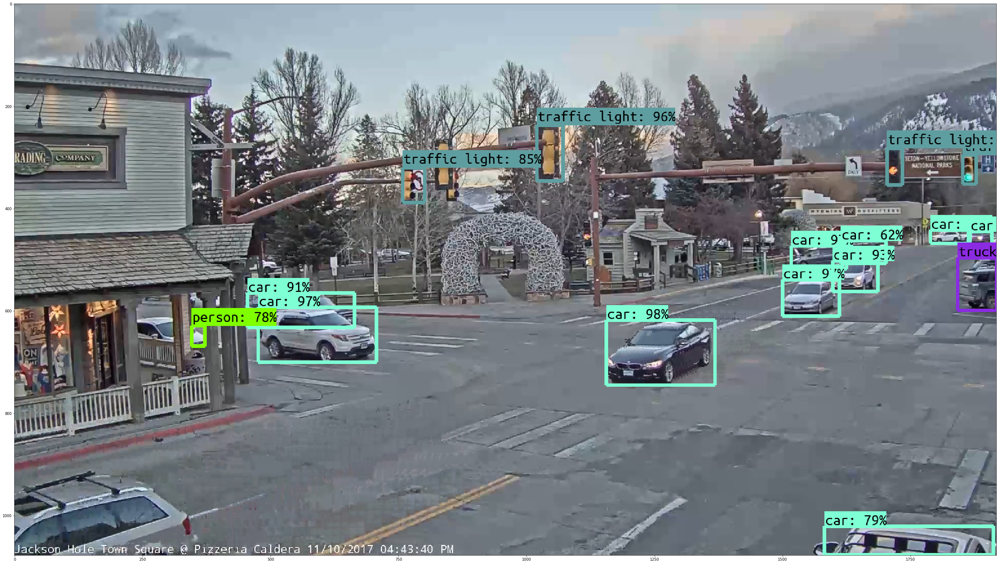

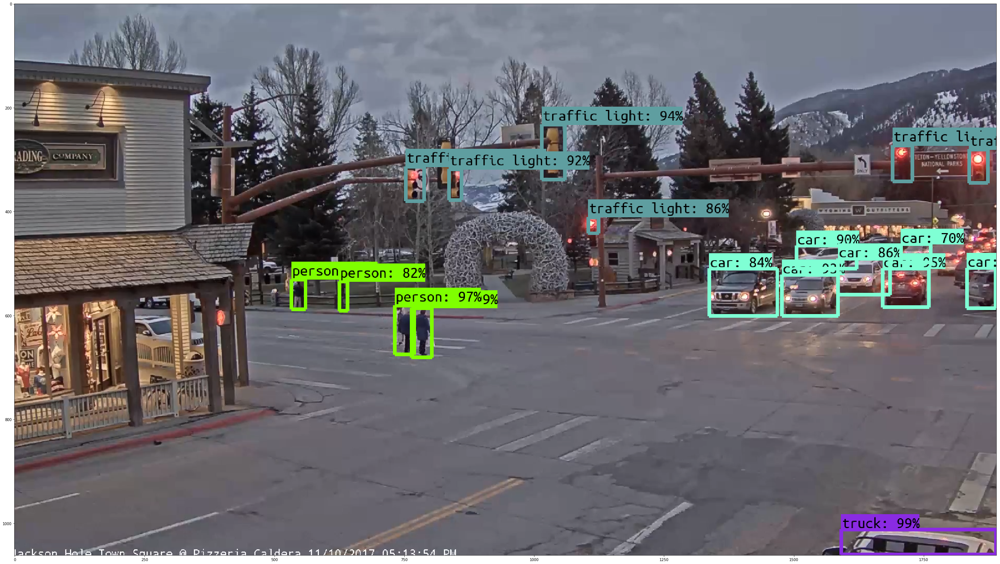

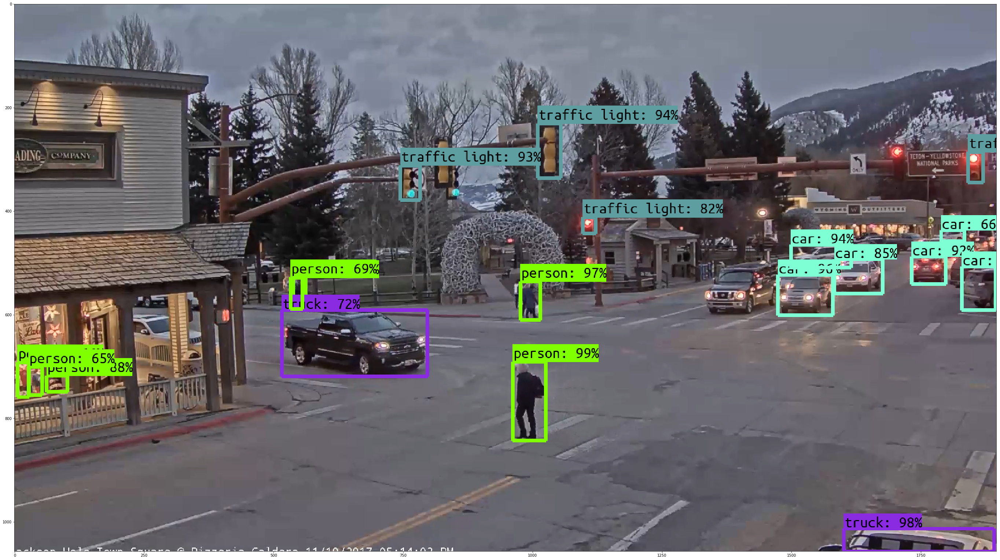

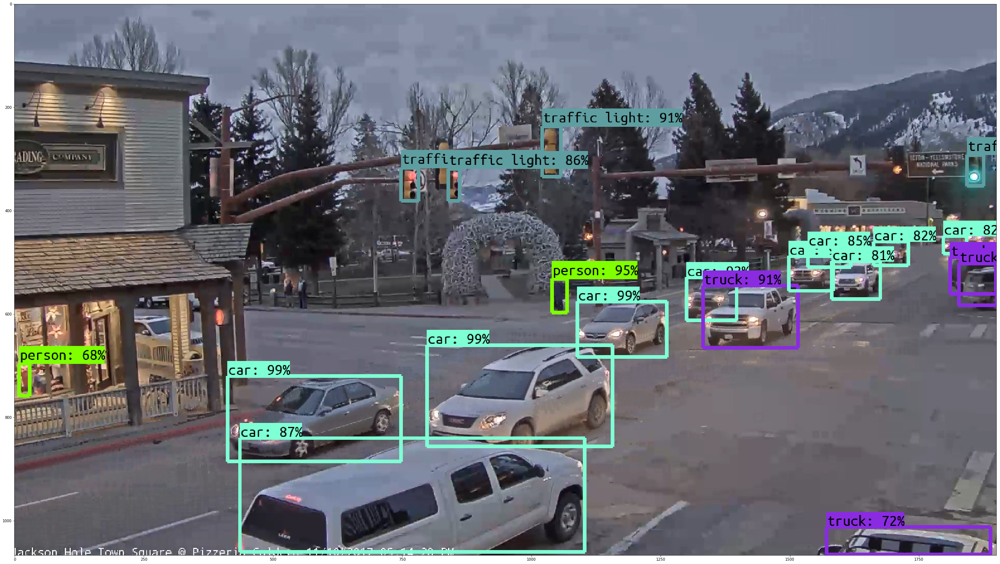

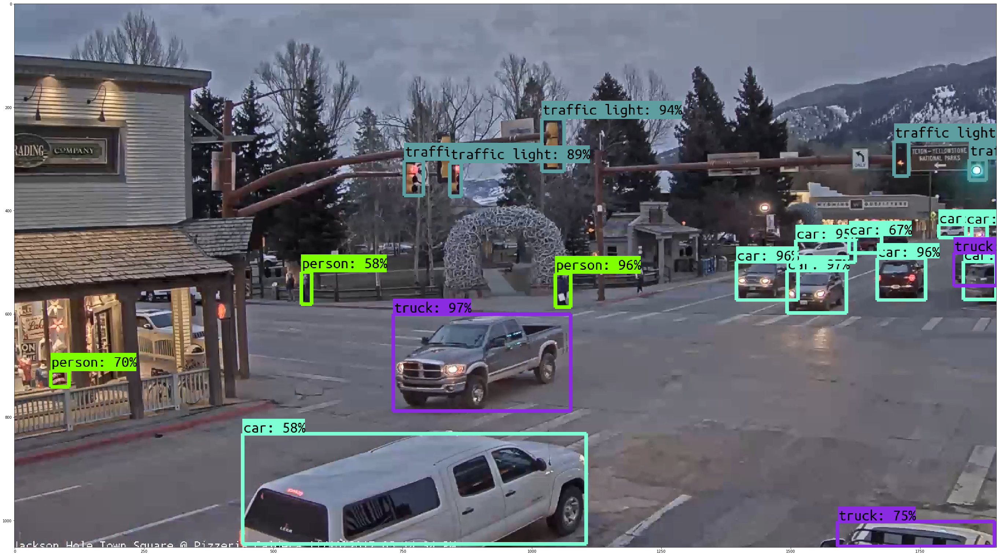

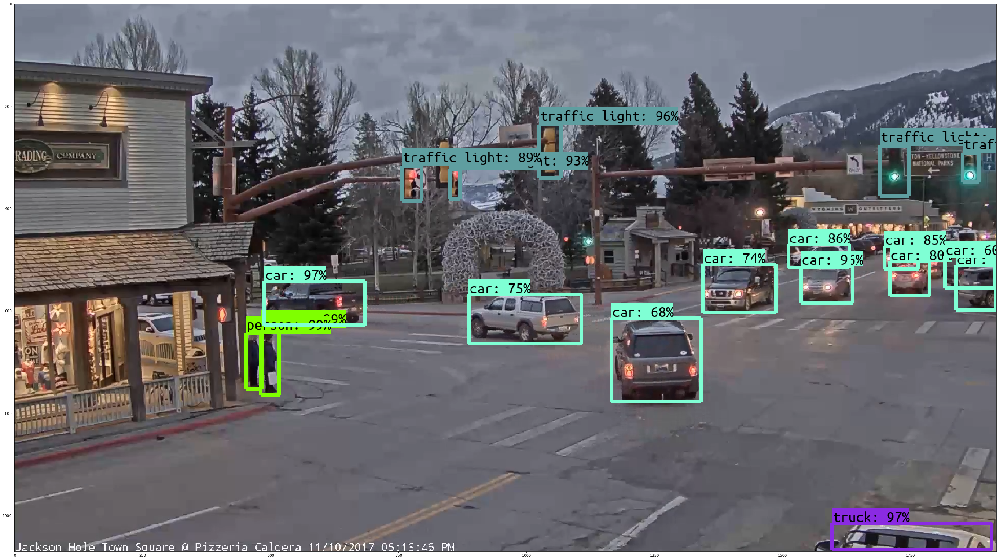

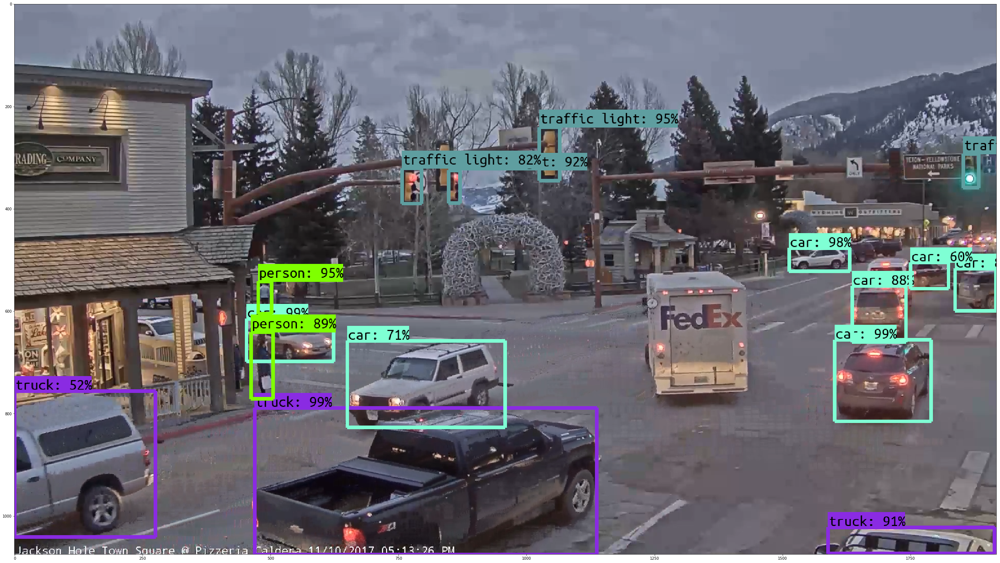

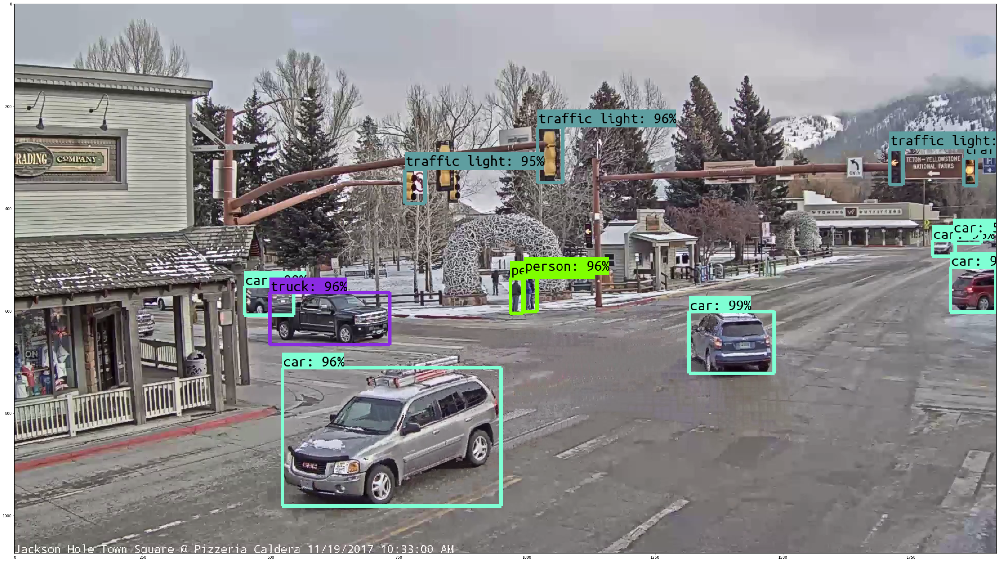

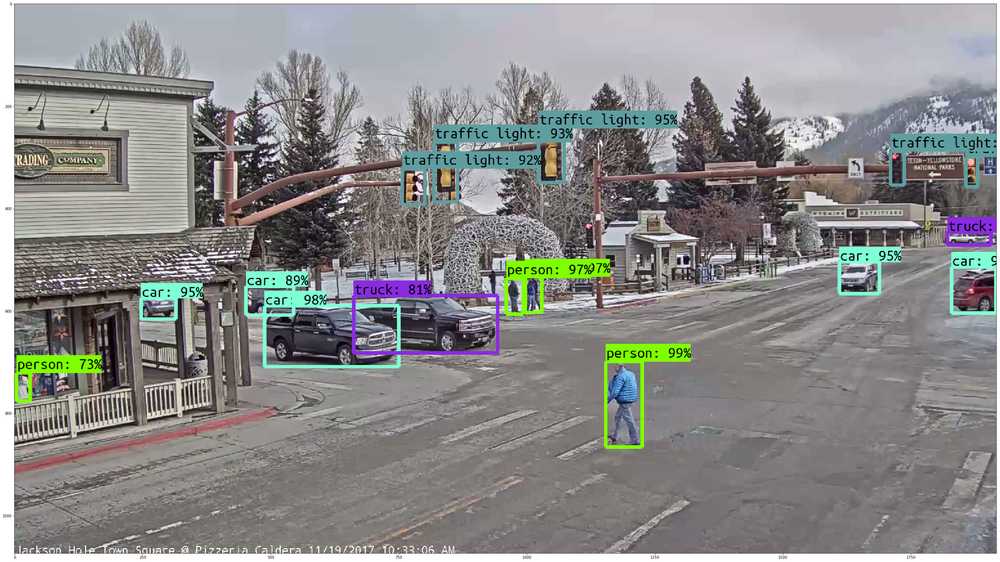

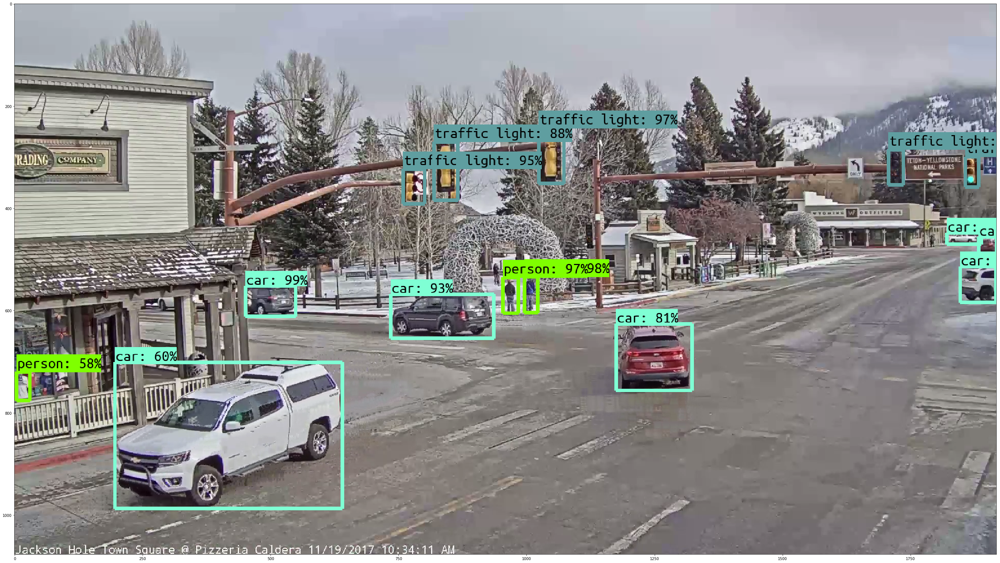

In [18]:
with detection_graph.as_default():
    with tf.Session(graph=detection_graph) as sess:
    # Definite input and output Tensors for detection_graph
        image_tensor = detection_graph.get_tensor_by_name('image_tensor:0')
        # Each box represents a part of the image where a particular object was detected.
        detection_boxes = detection_graph.get_tensor_by_name('detection_boxes:0')
        # Each score represent how level of confidence for each of the objects.
        # Score is shown on the result image, together with the class label.
        detection_scores = detection_graph.get_tensor_by_name('detection_scores:0')
        detection_classes = detection_graph.get_tensor_by_name('detection_classes:0')
        num_detections = detection_graph.get_tensor_by_name('num_detections:0')
        for image_path in TEST_IMAGE_PATHS:
            # Preprocessing begins
            begin_img_tonumpy = time.time()
            # imageio module will load directly to numpy array
            image_np = imageio.imread(image_path)
            print("Time to convert img to numpy: {} seconds".format(round(time.time() - begin_img_tonumpy, 3)))
            # Expand dimensions since the model expects images to have shape: [1, None, None, 3]
            image_np_expanded = np.expand_dims(image_np, axis=0)
            # Actual detection.
            now = time.time()
            (boxes, scores, classes, num) = sess.run(
              [detection_boxes, detection_scores, detection_classes, num_detections],
              feed_dict={image_tensor: image_np_expanded})
            print("Time for forward pass: {} seconds".format(round(time.time() - now, 3)))
            # Visualization of the results of a detection.
            now = time.time()
            vis_util.visualize_boxes_and_labels_on_image_array(
              image_np,
              np.squeeze(boxes),
              np.squeeze(classes).astype(np.int32),
              np.squeeze(scores),
              category_index,
              use_normalized_coordinates=True,
              line_thickness=7)
            print("Time for postprocessing: {} seconds".format(round(time.time() - now, 3)))
            plt.figure(figsize=IMAGE_SIZE)
            plt.imshow(image_np)
            plt.savefig('/home/cblythe2/github/jacksonvision/figures/boxed/{}'.format(os.path.basename(image_path)))